In [1]:
import numpy as np
import anndata
import pandas as pd
import scanpy as sc
import scipy.sparse
import scanpy.external as sce

import warnings
warnings.filterwarnings('ignore')

from sklearn.neighbors import (KNeighborsClassifier,NeighborhoodComponentsAnalysis)
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
from matplotlib import rcParams
sc.set_figure_params(dpi=100) # increase to make the figures bigger
import plotly.tools as tls

import seaborn as sns
sns.set(style="whitegrid")

import collections
import scipy.sparse as sp_sparse
import h5py


In [35]:
sc.settings.verbosity = 3            
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.10.2 pynndescent==0.5.8


In [36]:
##CLYTIA

In [3]:
#Loading matrices - /filtered directory from outs of STARsolo mapping
P2_2_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/jan23_P2/"
P2_2bis_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/jan23_P2bis/"
P4_1_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/jan23_P4/"
P4_1bis_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/jan23_P4bis/"
acme_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/anna_planula_hic/"
methanol_Path = "/Users/Julia/Documents/lbdv/scRNAseq_analysis/scRNAseq_clytia_Nov22/2nd_exp_Dec22/outs_mapping_unstranded_mitochondria_new_assembly_oct23/methanol/"
P2_2_Data = sc.read_10x_mtx(P2_2_Path) ; P2_2_Data.var_names_make_unique()
P2_2bis_Data = sc.read_10x_mtx(P2_2bis_Path) ; P2_2bis_Data.var_names_make_unique()
P4_1_Data = sc.read_10x_mtx(P4_1_Path) ; P4_1_Data.var_names_make_unique()
P4_1bis_Data = sc.read_10x_mtx(P4_1bis_Path) ; P4_1bis_Data.var_names_make_unique()
acme_Data = sc.read_10x_mtx(acme_Path) ; acme_Data.var_names_make_unique()
methanol_Data = sc.read_10x_mtx(methanol_Path) ; methanol_Data.var_names_make_unique()

In [4]:
#Metadata
P2_2_Data.obs['type']="clytia"
P2_2_Data.obs['sample']="P3.1"
P2_2_Data.obs['Batch']="2"
P2_2_Data.obs['stage']="P3"

P2_2bis_Data.obs['type']="clytia"
P2_2bis_Data.obs['sample']="P3.2"
P2_2bis_Data.obs['Batch']="2"
P2_2bis_Data.obs['stage']="P3"

P4_1_Data.obs['type']="clytia"
P4_1_Data.obs['sample']="P2.1"
P4_1_Data.obs['Batch']="2"
P4_1_Data.obs['stage']="P2"

P4_1bis_Data.obs['type']="clytia"
P4_1bis_Data.obs['sample']="P2.2"
P4_1bis_Data.obs['Batch']="2"
P4_1bis_Data.obs['stage']="P2"

acme_Data.obs['type']="clytia"
acme_Data.obs['sample']="acme"
acme_Data.obs['Batch']="1"
acme_Data.obs['stage']="P2"


methanol_Data.obs['type']="clytia"
methanol_Data.obs['sample']="methanol"
methanol_Data.obs['Batch']="1"
methanol_Data.obs['stage']="P2"

In [5]:
#Merging
chem = P2_2_Data.concatenate(P2_2bis_Data,P4_1_Data,P4_1bis_Data, acme_Data, methanol_Data,join='outer') 
print(chem.obs['sample'].value_counts())
print(chem.obs['Batch'].value_counts())
chem

acme        4890
P3.2        3866
P3.1        3588
methanol    2888
P2.1        2051
P2.2        1802
Name: sample, dtype: int64
2    11307
1     7778
Name: Batch, dtype: int64


AnnData object with n_obs × n_vars = 19085 × 18755
    obs: 'type', 'sample', 'Batch', 'stage', 'batch'
    var: 'gene_ids', 'feature_types'

In [6]:
#Label mitochondrial genes tagged in the gtf file used for the mapping
chem.var['mt'] = chem.var_names.str.startswith('XLOC_MITO')
chem.var

,gene_ids,feature_types,mt
XLOC_019238,XLOC_019238,Gene Expression,False
MSTRG.10,MSTRG.10,Gene Expression,False
XLOC_004572,XLOC_004572,Gene Expression,False
MSTRG.1000,MSTRG.1000,Gene Expression,False
MSTRG.10000,MSTRG.10000,Gene Expression,False
...,...,...,...
XLOC_041323,XLOC_041323,Gene Expression,False
XLOC_041324,XLOC_041324,Gene Expression,False
XLOC_041325,XLOC_041325,Gene Expression,False
XLOC_041298,XLOC_041298,Gene Expression,False


In [7]:
#Mitochondrial quality check
sc.pp.calculate_qc_metrics(chem, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)
mito_genes = chem.var_names.str.startswith('XLOC_MITO')
# For each cell compute fraction of counts in mito genes vs. all genes
chem.obs['percent_mt2'] = np.sum(chem[:, mito_genes].X, axis=1).A1 / np.sum(chem.X, axis=1).A1
# Add the total counts per cell as observations-annotation 
chem.obs['n_counts'] = chem.X.sum(axis=1).A1
chem

AnnData object with n_obs × n_vars = 19085 × 18755
    obs: 'type', 'sample', 'Batch', 'stage', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

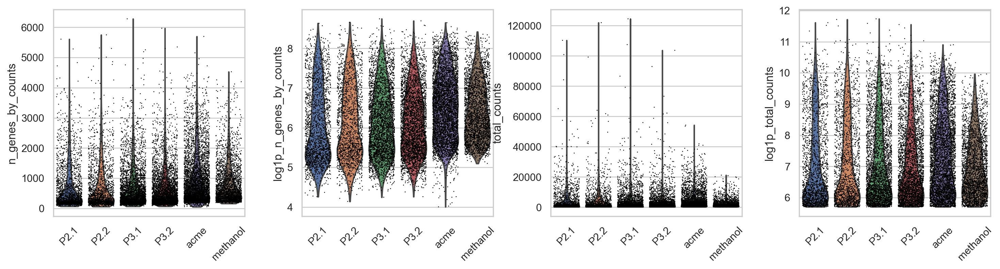

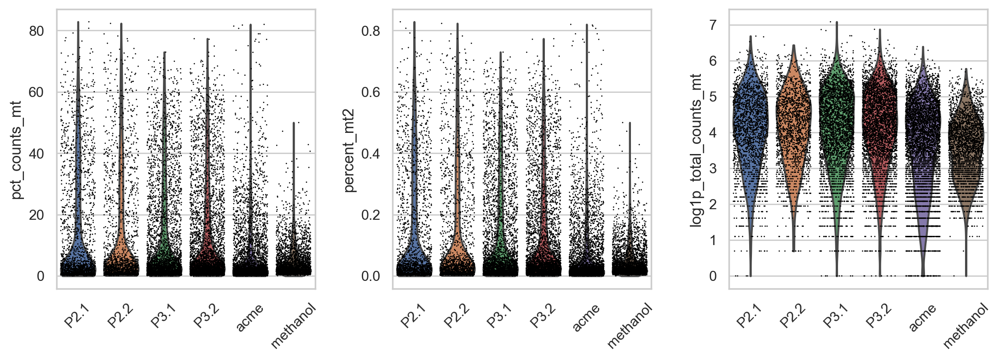

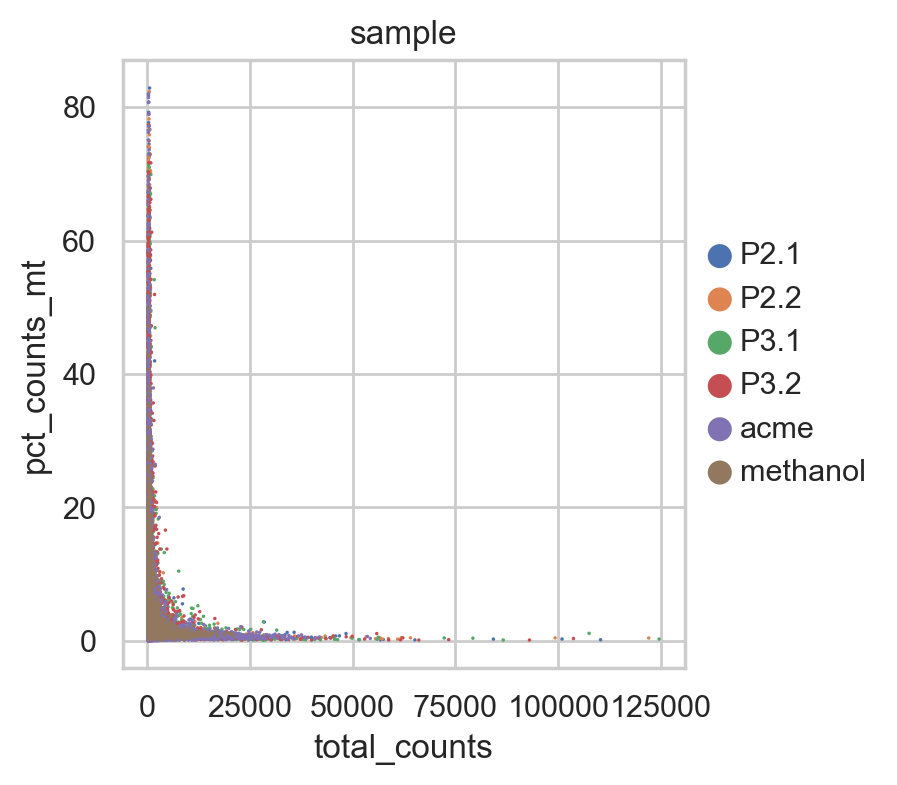

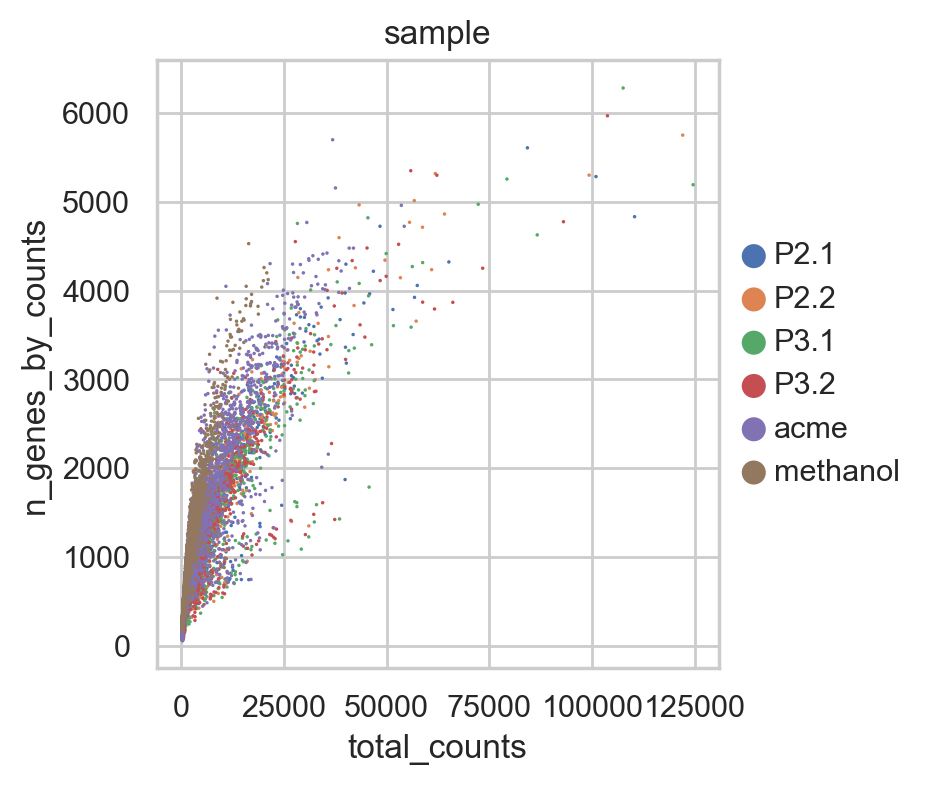

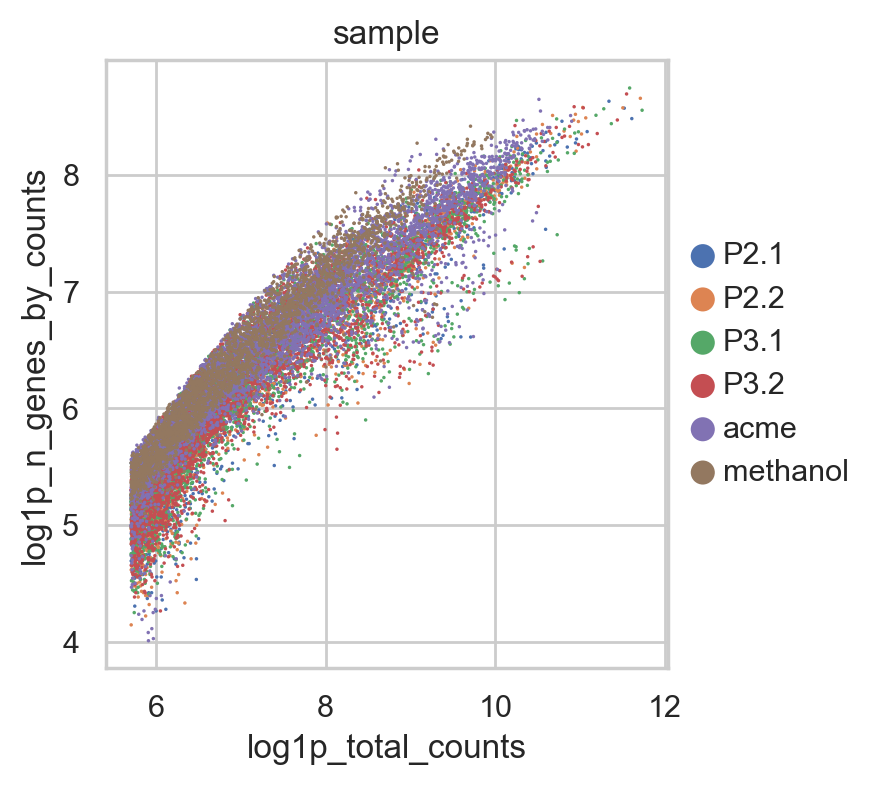

In [8]:
#Visulaize quality check measures
sc.pl.violin(chem, ['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)
sc.pl.violin(chem, ['pct_counts_mt', 'percent_mt2','log1p_total_counts_mt'],
             jitter=0.4, groupby = 'sample', rotation= 45, ncols=2)


sc.pl.scatter(chem, x='total_counts', y='pct_counts_mt', color="sample")
sc.pl.scatter(chem, x='total_counts', y='n_genes_by_counts', color="sample")
sc.pl.scatter(chem, x='log1p_total_counts', y='log1p_n_genes_by_counts', color="sample")

In [9]:
#Filter out outliers and % mitochondrial counts > 20%
chem = chem[chem.obs.n_genes_by_counts < 5000, :]
chem = chem[chem.obs.total_counts< 75000, :]
chem = chem[chem.obs.pct_counts_mt < 20, :]
chem


View of AnnData object with n_obs × n_vars = 15792 × 18755
    obs: 'type', 'sample', 'Batch', 'stage', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'sample_colors'

In [10]:
#Filtering by minimum number of genes and cells
sc.pp.filter_cells(chem, min_genes=200)
sc.pp.filter_genes(chem, min_cells=3)

print(chem.n_obs, chem.n_vars)

15368 17835


In [11]:
#Normalize and log transform
sc.pp.normalize_total(chem, target_sum=1e4)
sc.pp.log1p(chem)

#Compute  high variable genes
sc.pp.highly_variable_genes(chem, min_mean=0.0125, max_mean=3, min_disp=0.5)
chem.raw = chem

#Subset to highly variable genes to reduce noise
chem = chem[:, chem.var.highly_variable]
#Data regression
sc.pp.regress_out(chem, ['total_counts', 'pct_counts_mt'])
#Data scaling
sc.pp.scale(chem, max_value=10)
#Compute PCs
sc.tl.pca(chem, svd_solver='arpack')

In [12]:
#Run harmony to correct batch effect
import scanpy.external as sce
sce.pp.harmony_integrate(chem, 'Batch',max_iter_harmony=20)

2024-11-14 15:36:36,283 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-11-14 15:36:39,188 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-11-14 15:36:39,232 - harmonypy - INFO - Iteration 1 of 20
2024-11-14 15:36:41,102 - harmonypy - INFO - Iteration 2 of 20
2024-11-14 15:36:43,038 - harmonypy - INFO - Iteration 3 of 20
2024-11-14 15:36:44,781 - harmonypy - INFO - Iteration 4 of 20
2024-11-14 15:36:46,534 - harmonypy - INFO - Iteration 5 of 20
2024-11-14 15:36:48,053 - harmonypy - INFO - Iteration 6 of 20
2024-11-14 15:36:49,371 - harmonypy - INFO - Iteration 7 of 20
2024-11-14 15:36:50,542 - harmonypy - INFO - Iteration 8 of 20
2024-11-14 15:36:51,649 - harmonypy - INFO - Iteration 9 of 20
2024-11-14 15:36:52,646 - harmonypy - INFO - Converged after 9 iterations


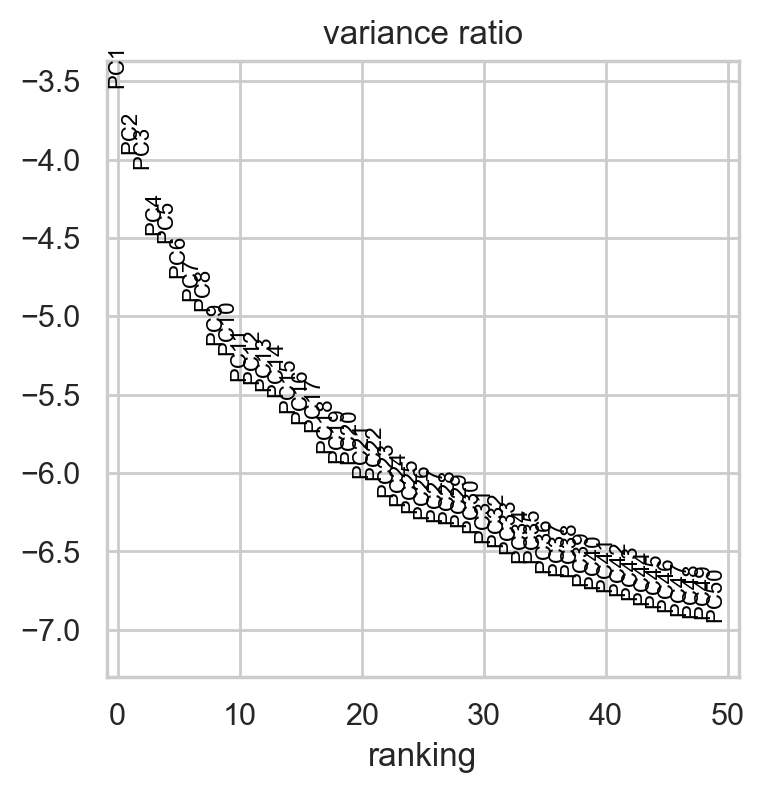

In [13]:
#Elbow plot of PCs
sc.pl.pca_variance_ratio(chem, log=True, n_pcs = 50)

In [14]:
#Custering - 1) Compute neighbors graph using x_pca computed with harmony
sc.pp.neighbors(chem, n_neighbors=50, n_pcs=22, knn=True, use_rep='X_pca_harmony')

#Custering - 2)Apply the Leiden graph-clustering algorithm
sc.tl.leiden(chem,resolution=1) #Control granularity of clusters

#Computing umap
sc.tl.umap(chem)

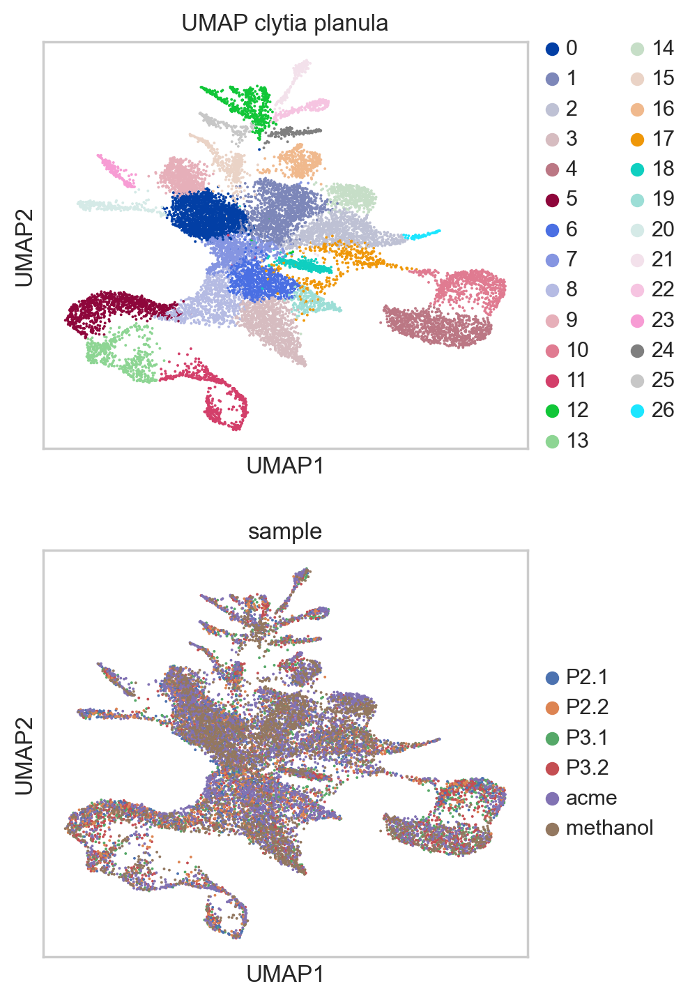

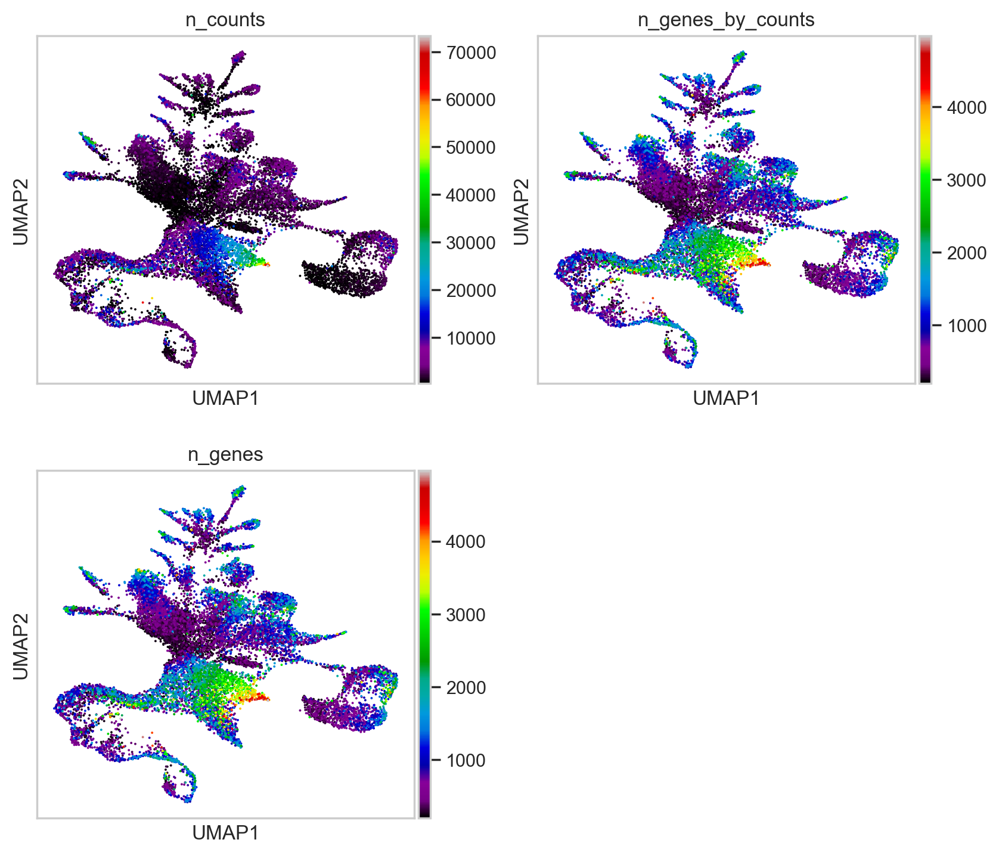

In [15]:
#Visualize umap
sc.pl.umap(chem, color=['leiden','sample'], title="UMAP clytia planula",ncols=1)
sc.pl.umap(chem, color=['n_counts', 'n_genes_by_counts', 'n_genes'],color_map='nipy_spectral', ncols=2)


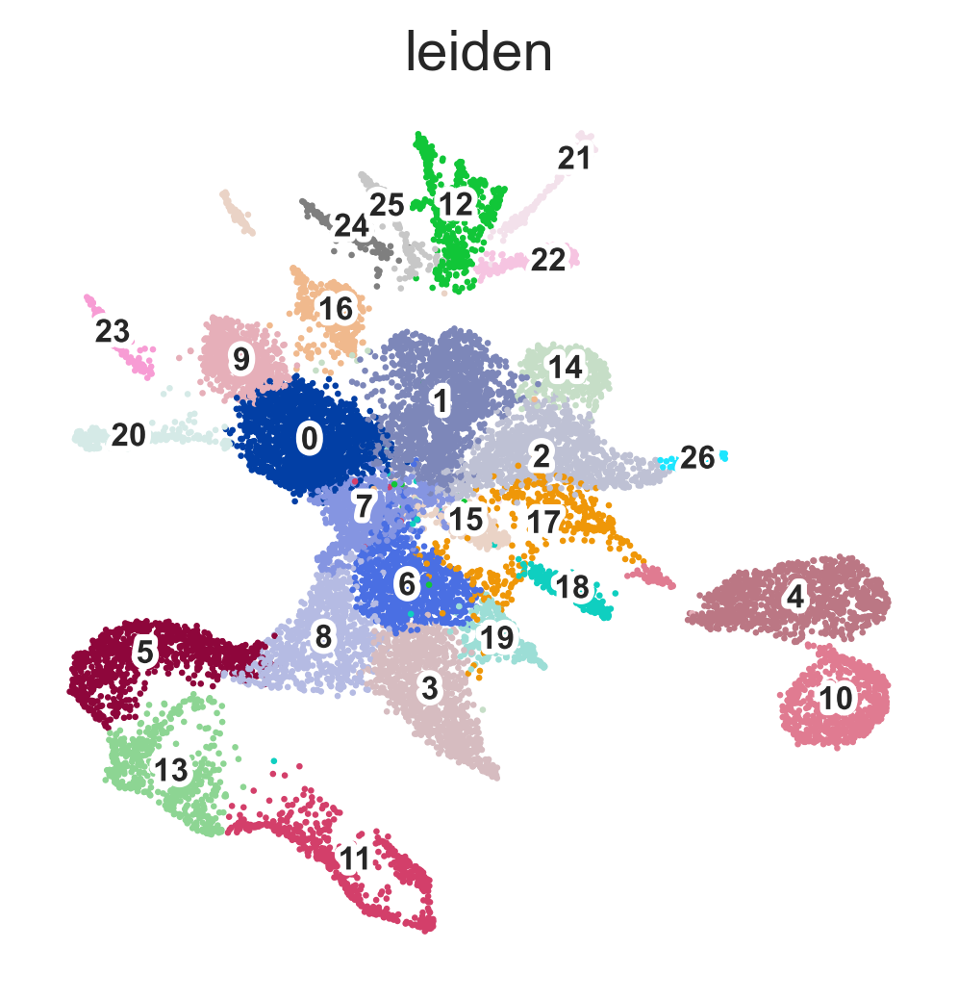

In [16]:
#sc.pl.umap(chem, color=['leiden'], legend_loc= 'on data', legend_fontsize=8, legend_fontoutline=3,  size= 10, frameon=False)


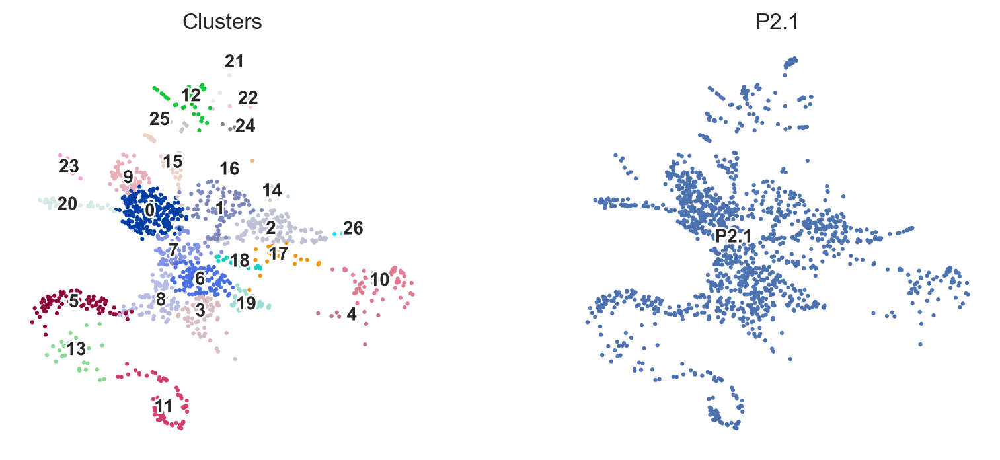

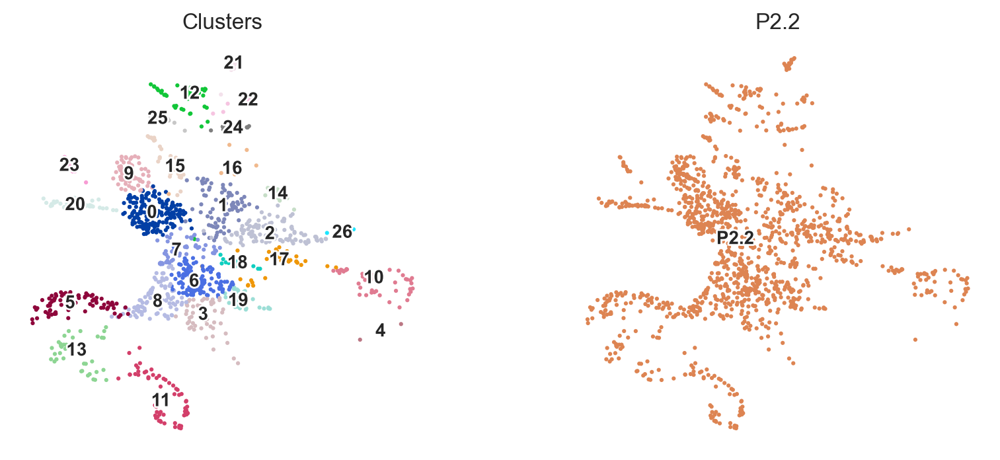

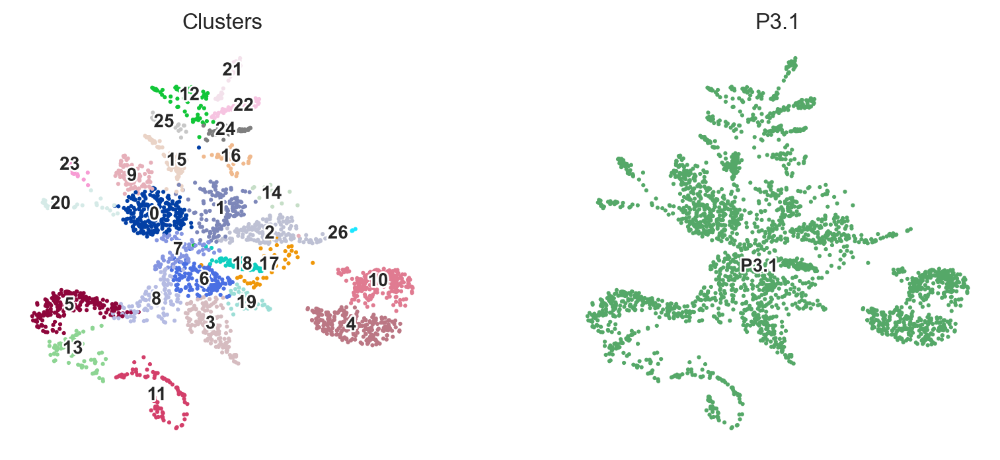

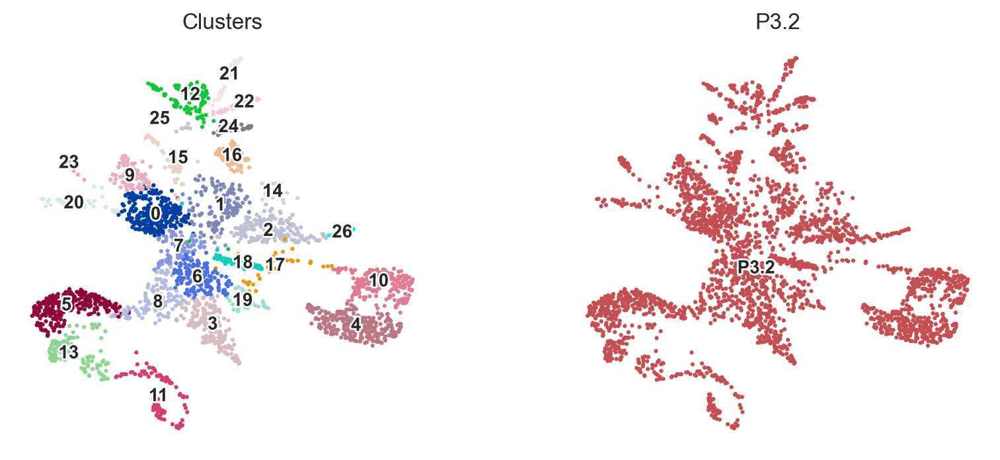

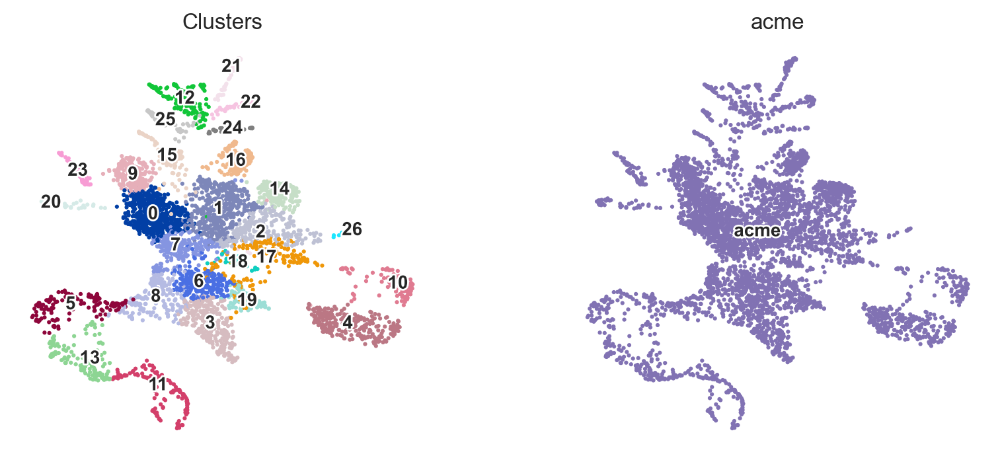

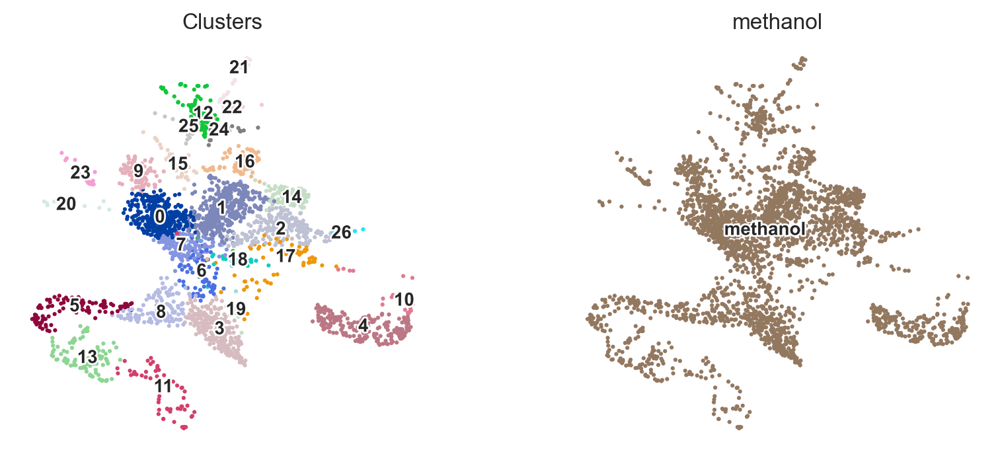

In [16]:
#Plot libraries individually
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['P2.1'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'P2.1'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['P2.2'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'P2.2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['P3.1'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'P3.1'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['P3.2'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'P3.2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['acme'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'acme'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['sample'].isin(['methanol'])].index.tolist(), ], color= ['leiden','sample'], title=['Clusters', 'methanol'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)


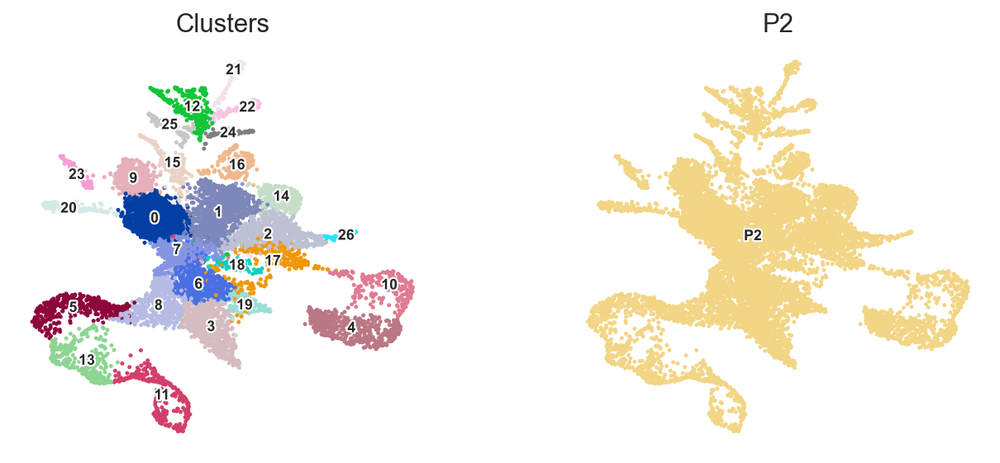

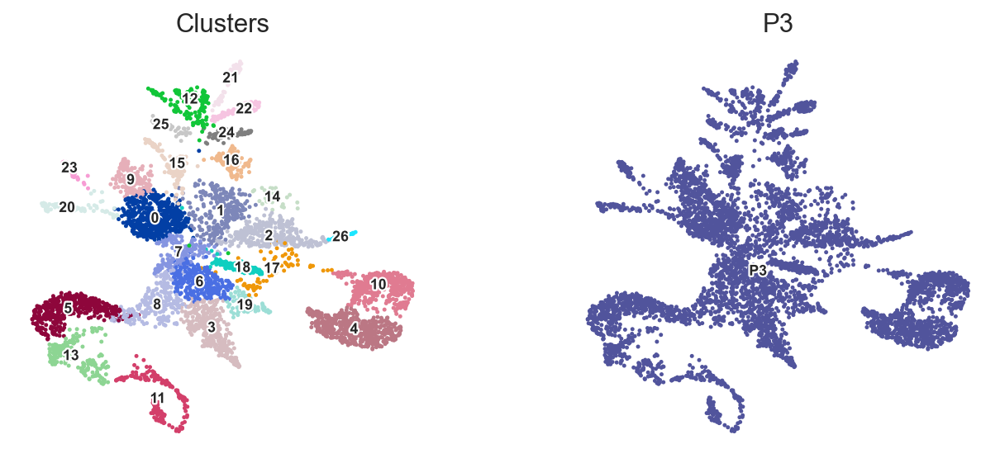

In [17]:
#Plot libraries individually for each planula stage
sc.settings.set_figure_params(dpi=80, facecolor='white')
chem.uns['stage_colors'] = ['#F2D585', '#51549C'] 
sc.pl.umap(chem[chem.obs.loc[chem.obs['stage'].isin(['P2'])].index.tolist(), ], color= ['leiden','stage'], title=['Clusters', 'P2'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem[chem.obs.loc[chem.obs['stage'].isin(['P3'])].index.tolist(), ], color= ['leiden','stage'], title=['Clusters', 'P3'], legend_loc= 'on data',  legend_fontsize=8, legend_fontoutline=2,  frameon=False, size=20,ncols=2)


In [18]:
#Rank and extract marker genes for all clusters
sc.tl.rank_genes_groups(chem, 'leiden', n_genes=1000,method='wilcoxon')

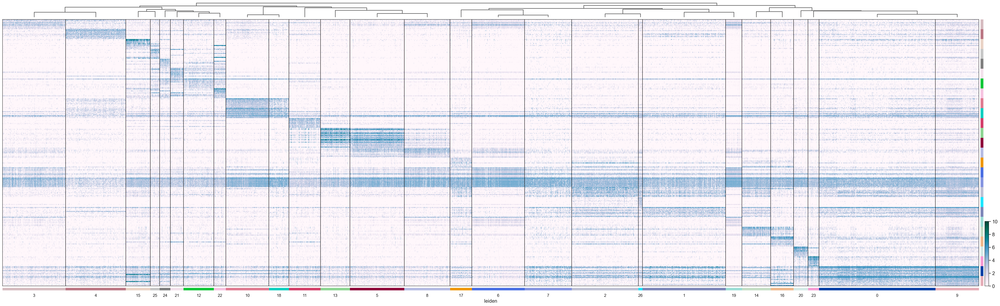

In [19]:
#Heatmap of top 10 marker genes per cluster
sc.tl.dendrogram(chem, 'leiden', n_pcs=22)
sc.pl.rank_genes_groups_heatmap(chem, n_genes=10, swap_axes=True, vmin=0, vmax=10, cmap='PuBuGn', show=True, figsize=(50,15))

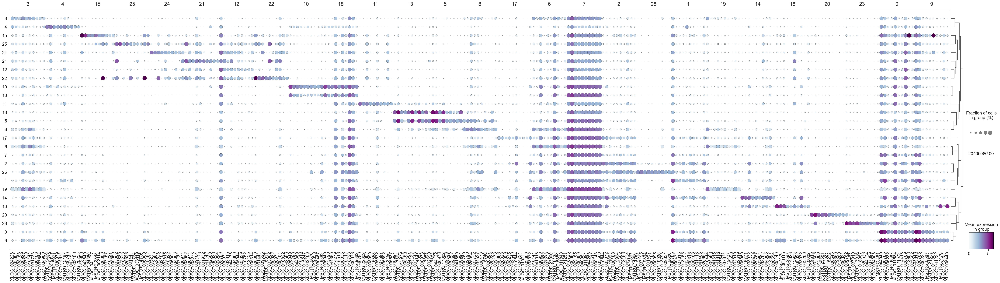

In [20]:
#Dotplot of top 10 marker genes per cluster
sc.settings.set_figure_params(facecolor='white',fontsize=18)
sc.pl.rank_genes_groups_dotplot(chem, n_genes=10, groupby='leiden', cmap='BuPu', show=True, figsize=(60,15))

In [21]:
#Remove cluster 7
chem = chem.raw.to_adata()
chem.obs['leiden'].cat.categories
chem_new = chem[~chem.obs['leiden'].isin(['7']),:].copy()
chem_new

AnnData object with n_obs × n_vars = 14627 × 17835
    obs: 'type', 'sample', 'Batch', 'stage', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mt2', 'n_counts', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'sample_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'stage_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    obsp: 'distances', 'connectivities'

In [22]:
#Re-compute clustering
sc.pp.neighbors(chem_new, n_neighbors=50, n_pcs=22, knn=True)
sc.tl.leiden(chem_new,key_added='leiden_new',resolution=1) 
sc.tl.umap(chem_new)
chem_new.obs['newClusters'] = pd.Categorical(chem_new.obs['leiden_new'] )

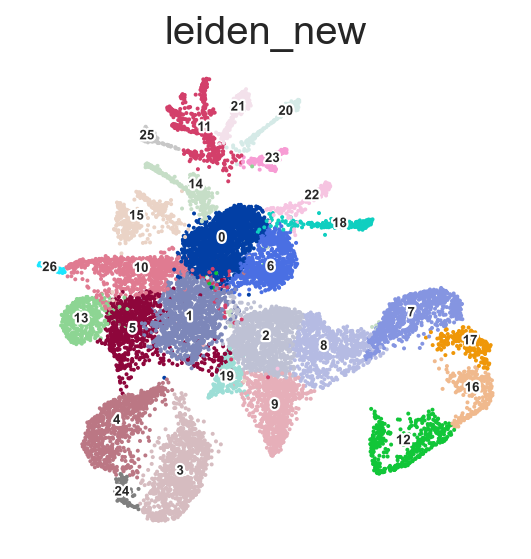

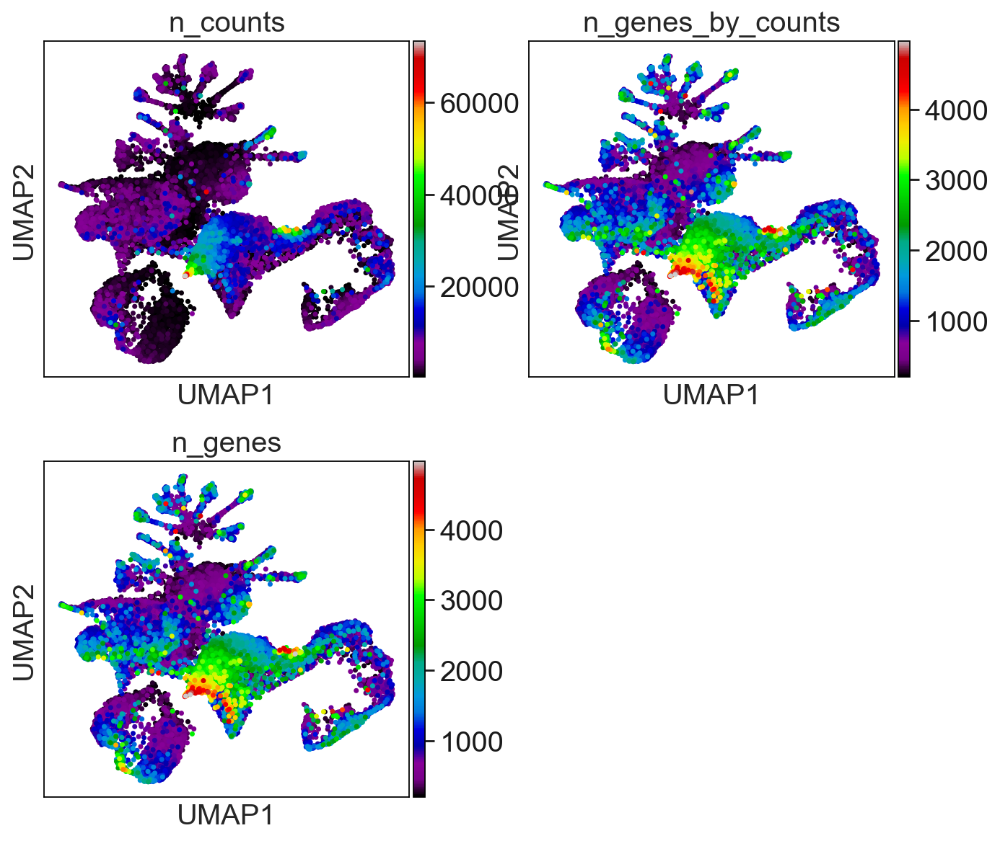

In [23]:
#Final UMAP
sc.pl.umap(chem_new, color=['leiden_new'], legend_loc= 'on data', legend_fontsize=6, legend_fontoutline=2, size= 13, frameon=False)
sc.pl.umap(chem_new, color=['n_counts', 'n_genes_by_counts', 'n_genes'],color_map='nipy_spectral', ncols=2, size=40)


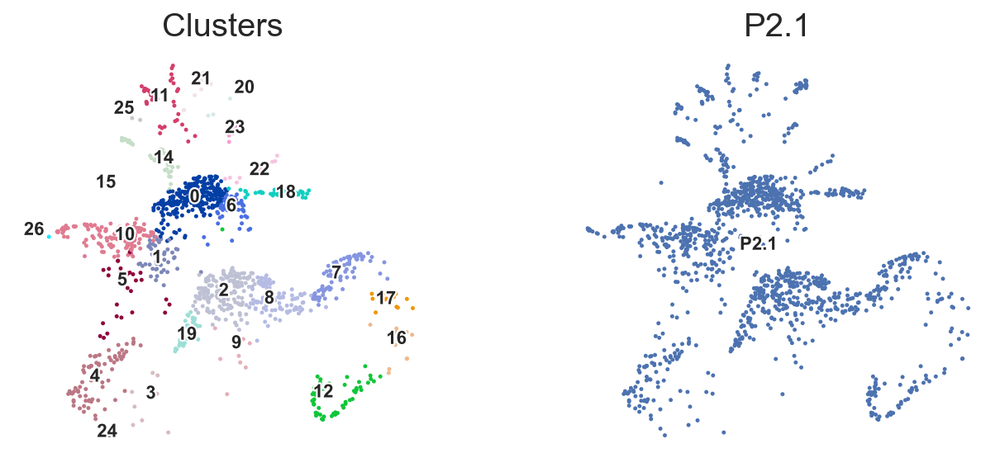

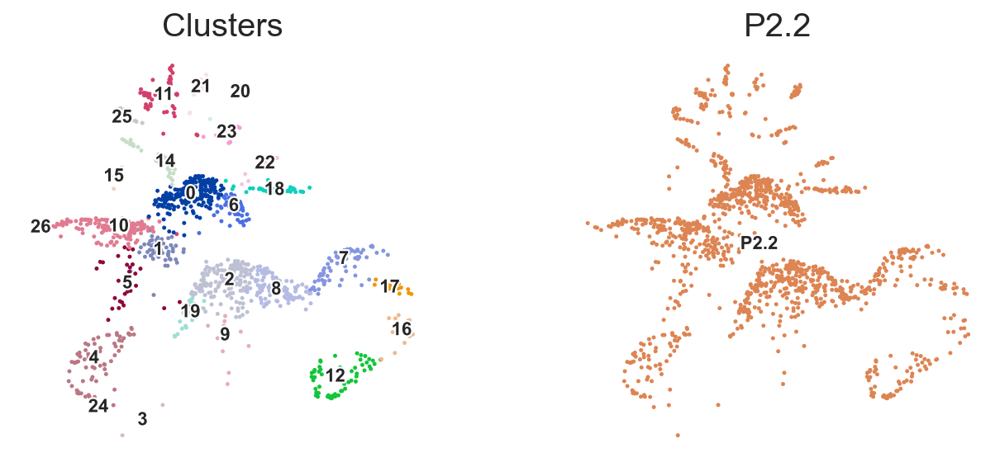

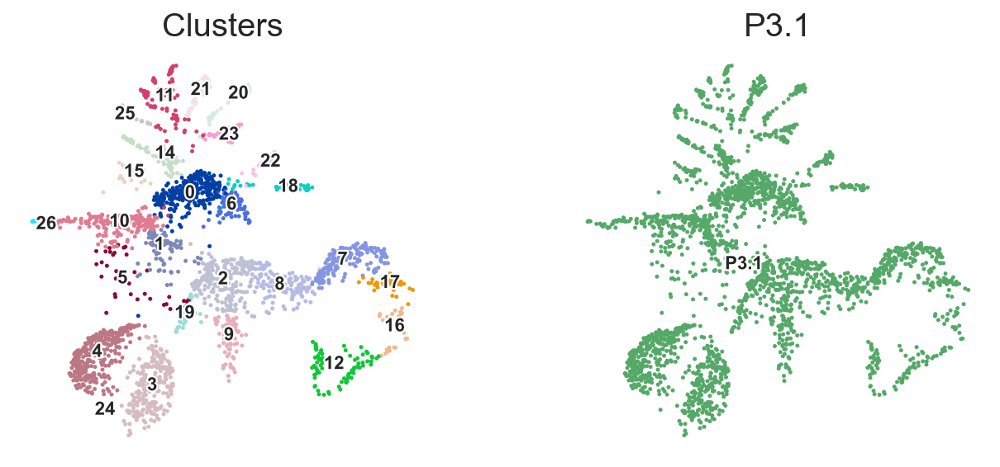

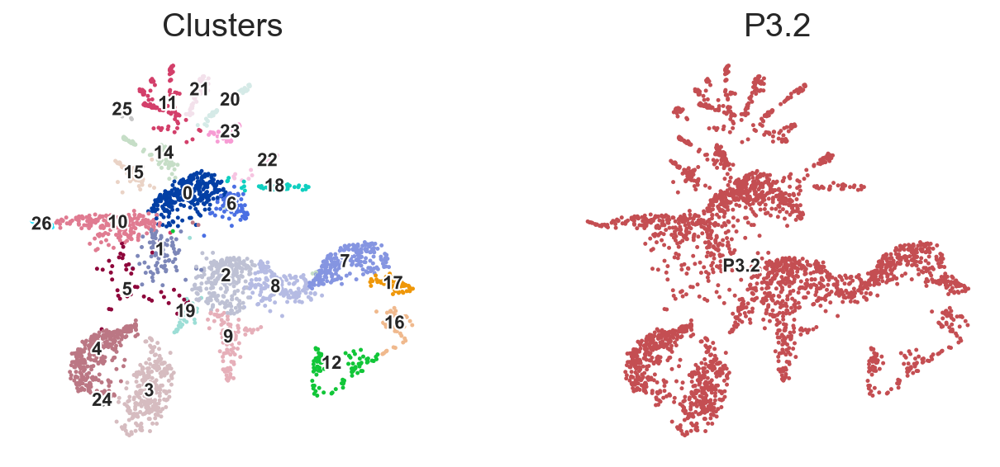

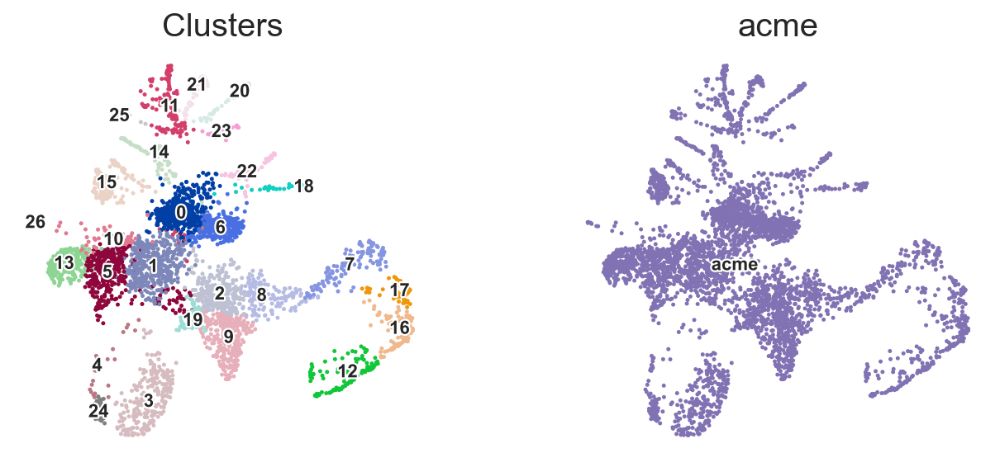

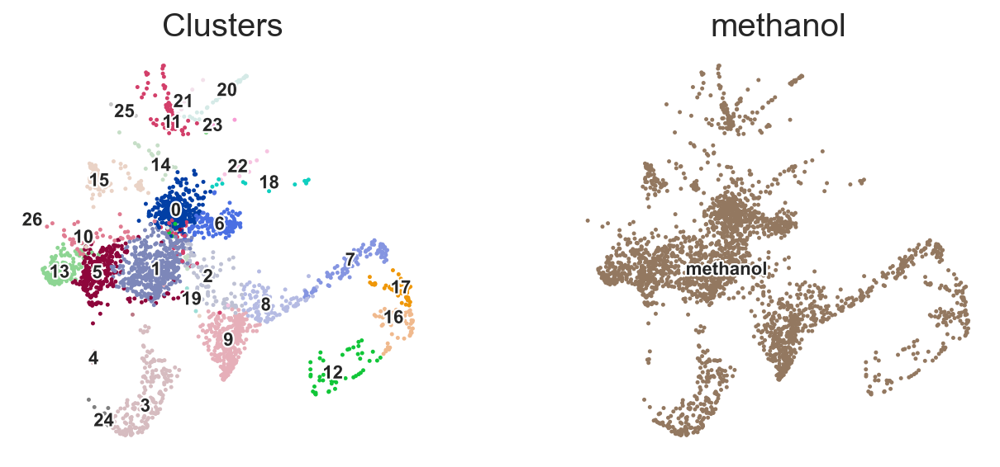

In [24]:
#Plot samples individually
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['P2.1'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'P2.1'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['P2.2'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'P2.2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['P3.1'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'P3.1'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['P3.2'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'P3.2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['acme'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'acme'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['sample'].isin(['methanol'])].index.tolist(), ], color= ['leiden_new','sample'], title=['Clusters', 'methanol'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)


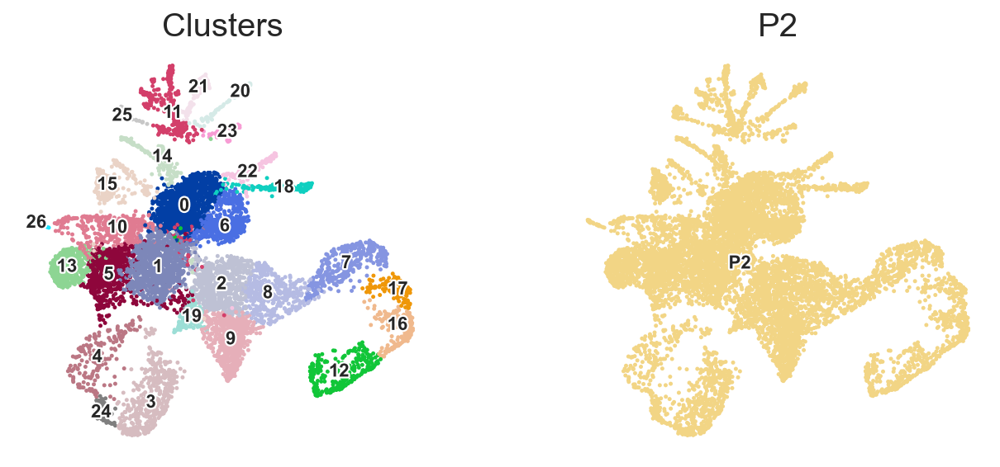

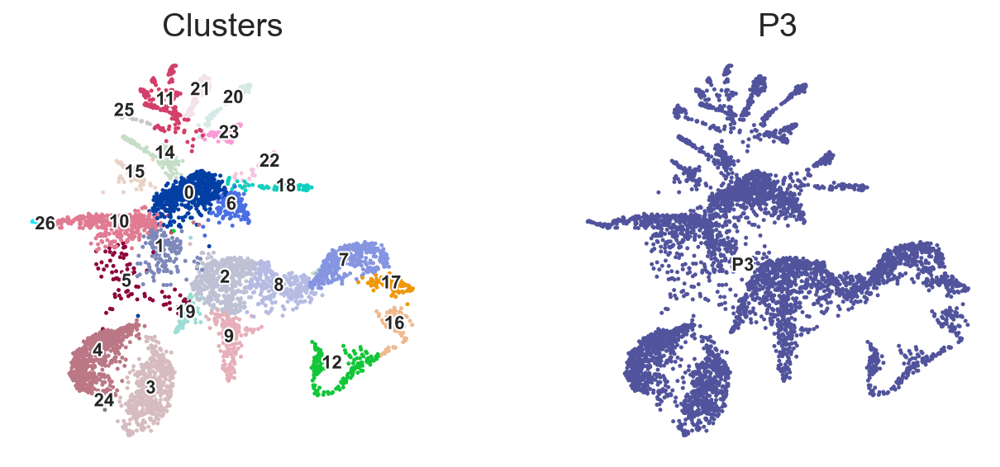

In [25]:
#Plot libraries individually for each planula stage
chem_new.uns['stage_colors'] = ['#F2D585', '#51549C'] 
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['stage'].isin(['P2'])].index.tolist(), ], color= ['leiden_new','stage'], title=['Clusters', 'P2'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)
sc.pl.umap(chem_new[chem_new.obs.loc[chem_new.obs['stage'].isin(['P3'])].index.tolist(), ], color= ['leiden_new','stage'], title=['Clusters', 'P3'], legend_loc= 'on data',  legend_fontsize=10, legend_fontoutline=2,  frameon=False, size=20,ncols=2)


In [26]:
#Rank and extract marker genes for all clusters
sc.tl.rank_genes_groups(chem_new, 'leiden_new', n_genes=1000,method='wilcoxon')

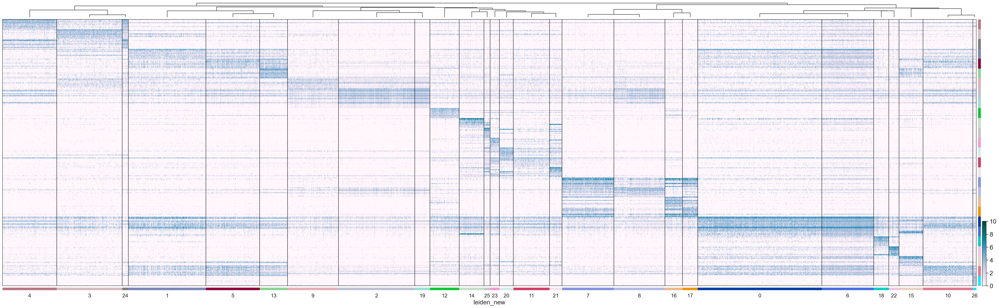

In [27]:
#Heatmap of top 10 marker genes per cluster
#sc.settings.set_figure_params(dpi=80, facecolor='white',fontsize=25)
sc.tl.dendrogram(chem_new, 'leiden_new', n_pcs=22)
sc.pl.rank_genes_groups_heatmap(chem_new, n_genes=10, swap_axes=True, vmin=0, vmax=10, cmap='PuBuGn', show=True, figsize=(50,15))

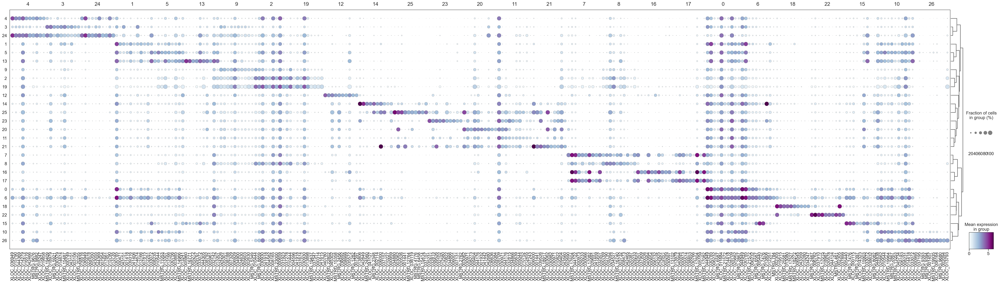

In [28]:
#Dotplot of top 10 marker genes per cluster
sc.pl.rank_genes_groups_dotplot(chem_new, n_genes=10, groupby='leiden_new', cmap='BuPu', show=True, figsize=(60,15))

In [29]:
#Make a dataframe with cluster marker genes
clusters = np.unique(chem_new.obs['leiden_new'])
clusters = clusters.astype('int') 
clusters = np.sort(clusters)
clusters = clusters.astype('str') 
markers_chem = pd.DataFrame() 
clus = []
markerGene = []
padj = []
logfoldchange = []
for i in clusters:
  genes = chem_new.uns['rank_genes_groups']['names'][str(i)]
  clus += list(np.repeat(i,len(genes)))
  markerGene += list(genes)
  padj += list(chem_new.uns['rank_genes_groups']['pvals_adj'][str(i)])
  logfoldchange += list(chem_new.uns ['rank_genes_groups']['logfoldchanges'][str(i)])
markers_chem['clus'] = clus
markers_chem['markerGene'] = markerGene
markers_chem['padj'] = padj
markers_chem['logfoldchange'] = logfoldchange


In [30]:
#Select only significant markers
significant = []
print(markers_chem)
for index,row in markers_chem.iterrows():
    if row['padj'] < 0.05:
        significant += "T"
    else:
        significant += "F"
markers_chem['significant'] = significant
significant_markers_chem = markers_chem[markers_chem.significant == "T"]


      clus   markerGene      padj  logfoldchange
0        0  XLOC_044949  0.000000       4.307343
1        0  XLOC_030785  0.000000       3.678264
2        0  XLOC_006232  0.000000       3.878091
3        0   MSTRG.6587  0.000000       3.613408
4        0  XLOC_011684  0.000000       1.795965
...    ...          ...       ...            ...
26995   26  XLOC_032992  0.999893       1.585935
26996   26  XLOC_000338  0.999893       1.556401
26997   26  XLOC_045622  0.999893       2.572471
26998   26   MSTRG.6056  0.999893       1.634940
26999   26   MSTRG.1288  0.999893       2.320586

[27000 rows x 4 columns]


In [57]:
#significant_markers_chem.to_csv('/Users/Julia/Desktop/supplementary_paper_Sept24/sc_atlases/clytia/clytia_significant_markers_FC.csv', sep =',')

<Axes:>

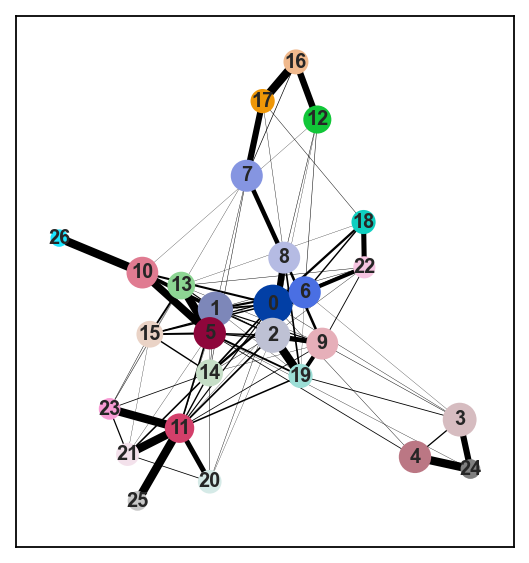

In [31]:
#PAGA connectivities
sc.tl.paga(chem_new, groups='leiden_new')
sc.pl.paga(chem_new, threshold=0.03, show=False,fontsize=9,edge_width_scale=0.5)

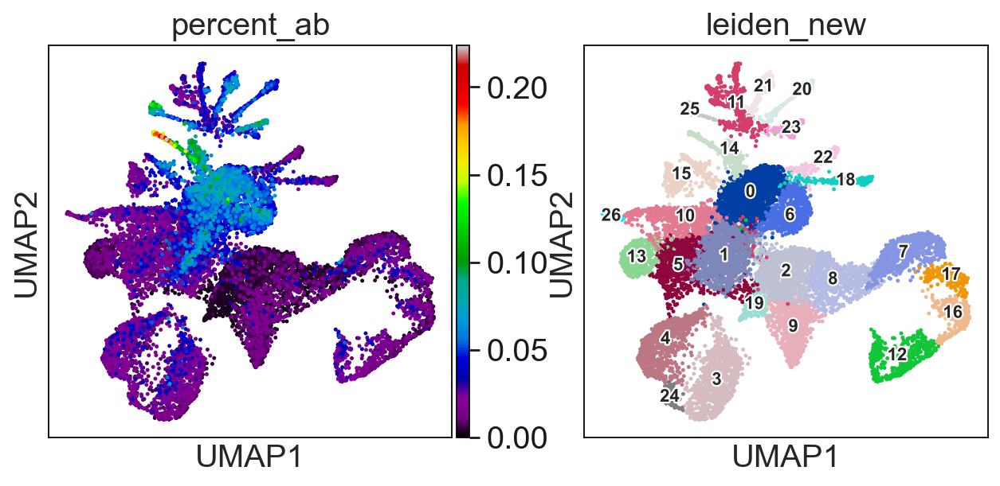

In [34]:
#Plot percentage of aboral genes per cluster in the umap
#upload gene IDs of aboral genes LFC>1, p-value<0.05
all_aboral = set()
with open('/Users/Julia/Documents/lbdv/python_scripts/aboral_clusters/IDs_clytia_new_assembly_aboral_lcf1.txt') as fh:
    for line in fh:
        line = line.rstrip()
        parts = line.split()
        all_aboral.add(parts[0])
aboral_genes = chem_new.var_names.isin(all_aboral)
chem_new.obs['percent_ab'] = np.sum(
   chem_new[:,aboral_genes].X, axis=1).A1 / np.sum(chem_new.X, axis=1).A1
sc.pl.umap(chem_new,color=['percent_ab','leiden_new'],size=20,color_map='nipy_spectral', legend_loc= 'on data' , legend_fontoutline=2, legend_fontsize=10)